In [6]:
import numpy as np
import matplotlib.pyplot as plt
import h5py
import json
import os
import mayavi
from mayavi import mlab
mlab.init_notebook('x3d', 600, 600) # x3d or png

Notebook initialized with x3d backend.


**Be careful with the shape**

(WTF)
Fortran     : nx, ny, nz

corresponds:

np.array    : nz, ny, nx

np.meshgrid : ny, nz, nx



In [7]:
nx = 20
ny = 20
nz = 20
X,Y,Z = np.meshgrid(np.arange(ny),np.arange(nz),np.arange(nx))
phi = np.zeros([nz,ny,nx])
u = np.zeros([nz,ny,nx])+ 1.0
v = np.zeros([nz,ny,nx]) + 1.0
w = np.zeros([nz,ny,nx]) + 1.0

In [8]:
phi[5:10,5:10,5:10] = 1.0

In [20]:
mlab.contour3d(phi,contours=8,opacity=.2 )
mlab.outline(extent=[0,20,0,30,0,40])

In [11]:
f2=h5py.File('input.h5','w')

OSError: Unable to create file (unable to truncate a file which is already open)

In [12]:
f2.create_group('phi')
grp = f2['phi']
grp.create_dataset("init", data=phi)
f2.create_group('u')
grp = f2['u']
grp.create_dataset("init", data=u)
f2.create_group('v')
grp = f2['v']
grp.create_dataset("init", data=v)
f2.create_group('w')
grp = f2['w']
grp.create_dataset("init", data=w)

<HDF5 dataset "init": shape (40, 30, 20), type "<f8">

In [13]:
f2.close()

In [36]:
f3=h5py.File('output.h5','r')

In [37]:
# init  = np.array(f2['phi']['final']) [:,:,:] 
final = np.array(f3['phi']['final']) [:,:,:] 
np.unique(final)

array([0.        , 0.00570238, 0.00923123, 0.01038008, 0.01658218,
       0.0181866 , 0.01818664, 0.01819244, 0.01819538, 0.01819992,
       0.01823889, 0.01829054, 0.01829157, 0.01865583, 0.01984418,
       0.0200599 , 0.03983872, 0.04989733, 0.05071457, 0.1769207 ,
       0.1805294 , 0.20563504, 0.31195337, 0.35150904, 0.35334803,
       0.35633639, 0.37458297, 0.37816381, 0.3796608 , 0.38191595,
       0.38590766, 0.38592687, 0.3859385 , 0.38595094, 0.38600727,
       0.38611438, 0.38622877, 0.38640788, 0.3878334 , 0.38822446,
       0.39651546, 0.42922389, 0.53566301, 0.58860729, 0.62265256,
       0.68804081, 0.78024459, 0.79789557, 0.8       , 1.        ])

In [38]:
mlab.contour3d(final,contours=8,opacity=.2 )

In [137]:
f3.close()

In [185]:
final=np.array(f3['phi']['final'])


In [130]:
np.unique(final)

array([0., 1.])

In [49]:
Z = np.zeros([10,20])

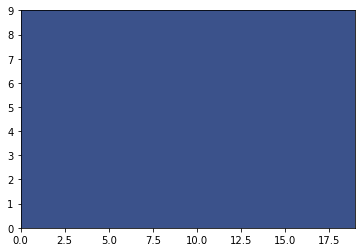

In [46]:
plt.contourf(X,Y,Z)

In [21]:
ff= np.zeros([2,2,2])
for i in range(2):
    for j in range(2):
        for k in range(2):
            ff[i,j,k] = i+j+k
np.savetxt('test.txt',ff)

ValueError: Expected 1D or 2D array, got 3D array instead